# Prelude

# Acknowledgements

# Code Starts Here

Libraries that I used

In [70]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.animation as animation
import cv2
import scipy as sp
from scipy.ndimage import maximum_filter
from scipy.ndimage import binary_erosion
from IPython.display import Image as display_image

image_repository  = "./Images/"

## The functions that I made and what they do

> ##### ${\tt show\_fft(A, title, mean_center)}$
> Takes in  three arguements: ${\tt A}$, ${\tt title}$, and ${\tt mean\_center}$. <br>
> Gets a binary image of size $(N, N)$ and plots the image, its 2D Fourier Transform, Shifted 2D Fourier Transform, and Shifted 2D Fourier Transform in a logarithmic scale. <br>
> <br>
> Arguments: <br>
> $\;\;\;\;$ ${\tt A}$: The aperture that will be transofrmed using 2D FFT. <br>
> $\;\;\;\;$ ${\tt title}$: Serves as the title of the output graph
> $\;\;\;\;$ ${\tt mean\_center}$: Default is ${\tt False}$. If ${\tt True}$, the image is subtracted by its mean.

In [71]:
def show_fft(A, title, mean_center = False):
    # Applying fft
    if mean_center == True:
        A = A  - np.mean(A)
    FA = abs(np.fft.ifft2(A))
    
    # Shifting 
    FAshifted = np.fft.fftshift(FA)
    
    # Plotting
    fig, ax = plt.subplots(1,3, figsize = (20,5))
    ax[0].imshow(A, cmap = "gray")
    ax[0].set_title(title)
    
    ax[1].imshow(FAshifted, cmap = "jet")
    ax[1].set_title("Shifted Fourier Transform", pad = 10)
    
    ax[2].imshow(np.log(FAshifted), cmap = "jet")
    ax[2].set_title("[Log scale] Shifted Fourier Transform", pad = 10)
    plt.tight_layout()
    plt.show()

> ##### ${\tt convert\_gs(filename, bw = False, inv = False, threshold)}$:
> Takes in four arguement: ${\tt filename}$, ${\tt bw}$, ${\tt inv}$, and ${\tt threshold}$. <br>
> Returns the grayscale of an image. The function can also binarize the image and invert it.
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt filename}$: Must be string. Pretty self explanatory lmao.<br>
> $\;\;\;\;$ ${\tt bw}$: Default value is False. If True, function converts image into a binary image.<br>
> $\;\;\;\;$ ${\tt inv}$: Default value is False. If True, converts 0s to 1s and 1s to 0s. in the image.<br>
> $\;\;\;\;$ ${\tt threshold}$: Default value is 0.3. This is the threshold for converting the grayscale image into a binary image. All values less than or equal to the threshold are set to 0 while the values above are set to 1. <br>
> <br>
> <br>
> ${\tt Notes}$<br>
> $\;\;\;\;$ ${\tt inv}$ will only work if ${\tt bw}$ is True. Otherwise, you will get an error message saying "lmao cant do that.". I did this because I didn't feel the need to invert grayscale images. I think that I only need to invert binary images.

In [72]:
def convert_gs(filename, binary = False, invert = False, threshold = 0.3):
    image = Image.open(image_repository + filename)
    gs_image = np.array(image.convert('L'))
    
    if binary == True:
        gs_image = (gs_image - np.min(gs_image))/(np.max(gs_image) - np.min(gs_image))
        gs_image[gs_image > threshold] = 1
        gs_image[gs_image <= threshold] = 0
        
        
    if binary == True and invert == True:
        gs_image = gs_image - 1
        gs_image = gs_image*(-1)
        
        
    if binary == False and invert == True:
        print("lmao cant do that.")
    return gs_image

> ##### ${\tt make\_corrugated(f, theta)}$:
> Takes in two arguement: ${\tt f}$ and ${\tt theta}$. <br>
> Returns a $256\times 256$ array containing a sinusoid with a frequency of ${\tt f}$ and rotated coutner-clockwise by ${\tt theta}$
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt f}$: The frequency of the sinusoid. Accepts any real number. <br>
> $\;\;\;\;$ ${\tt theta}$: The angle of rotation of the sinusoid. Accepts any real number<br>


In [73]:
def make_corrugated(f, theta):
    x = np.linspace(-1,1,256)
    y = np.linspace(-1,1,256)
    X,Y = np.meshgrid(x,y)
    Z = np.sin(2*np.pi*f*(Y*np.sin(theta) + X*np.cos(theta)))
    return Z

> ##### ${\tt fft\_animation(num\_frames)}$:
> Takes in one argument: ${\tt num\_frames}$ <br>
> Creates multiple graphs of sinusoids with a frequency and angle of rotation equal to its frame divided by $50$ (i.e. for the 30th frame, the sinusoid has a frequency of $30/50 ~\rm{Hz}$ and an angle of rotation of $30/50~\rm{rad}$). The frames are then compiled into a single GIF with an fps of 60.
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt num\_frames}$: The total number of frames to be used in the animation. <br>


In [74]:
def fft_animation(num_frames):
    fig, ax = plt.subplots(1,3,figsize = (15,6))

    def update(frame):
        f = 2*np.pi*frame/50
        theta =  np.pi*frame/50
        A = make_corrugated(f, theta)

        # Applying fft
        FA = abs(np.fft.ifft2(A))
    
        # Shifting 
        FAshifted = np.fft.fftshift(FA)

        fig.suptitle("2D sinusoid with $\omega$ = " + str(np.round(f, 3)) + " rad/s and θ = " +str(np.round(theta, 3))+ " rad", fontsize=16)

        ax[0].clear()
        ax[1].clear()
        ax[2].clear()


        ax[0].imshow(A, cmap = "gray")
        ax[0].set_title("Sinusoid")
        
        ax[1].imshow(abs(FAshifted), cmap = "jet")
        ax[1].set_title("FFT")

        ax[2].imshow(np.log(abs(FAshifted)), cmap = "jet")
        ax[2].set_title("[LOG SCALE] FFT")

    ani2 = animation.FuncAnimation(fig, update, frames = num_frames, interval=10, blit=False, repeat=False)
    writergif = animation.PillowWriter(fps=60)
    ani2.save(image_repository + "increasing.gif",writer=writergif)
    plt.close()
    

> ##### ${\tt masking(filename, mask)}$:
> Takes in two arguments: ${\tt filename}$ and ${\tt mask}$<br>
> Opens an image and filters it in the Fourier Space by multiplying it with a mask and reconstructs it back into its original coordinate space. This function displays the image, the mask, and the masked image.
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt filename}$: Must be string. Pretty self explanatory lmao.<br>
> $\;\;\;\;$ ${\tt mask}$: Must be a 2D array and must have the same shape as the image. <br>


In [75]:
def masking(filename, mask):
    image = np.array(Image.open(image_repository + filename))
    mask_shifted = np.fft.fftshift(mask)
    masked = np.zeros(image.shape)
    
    if (len(image.shape)) == 3:
        masked_R= np.fft.fft2(image[..., 0])*mask_shifted
        masked_G = np.fft.fft2(image[..., 1])*mask_shifted
        masked_B = np.fft.fft2(image[..., 2])*mask_shifted

        inv_R = abs(np.fft.ifft2(masked_R))
        inv_G = abs(np.fft.ifft2(masked_G))
        inv_B = abs(np.fft.ifft2(masked_B))

        #Normalizing values
        norm_inv_R = (inv_R - np.min(inv_R))/(np.max(inv_R) - np.min(inv_R))
        norm_inv_G = (inv_G - np.min(inv_G))/(np.max(inv_G) - np.min(inv_G))
        norm_inv_B = (inv_B - np.min(inv_B))/(np.max(inv_B) - np.min(inv_B))

        masked[..., 0] = norm_inv_R
        masked[..., 1] = norm_inv_G
        masked[..., 2] = norm_inv_B
        
        # plotting
        fig, ax = plt.subplots(1,3, figsize = (15,5))
        ax[0].imshow(image)
        ax[0].set_title("Image")

        ax[1].imshow(mask, cmap = "gray")
        ax[1].set_title("Mask")

        ax[2].imshow(masked)
        ax[2].set_title("Masked Image")

        plt.show()
        
    else:
        masked_img = np.fft.fft2(image)*mask_shifted
        inv_img = abs(np.fft.ifft2(masked_img))
        masked =  (inv_img - np.min(inv_img))/(np.max(inv_img) - np.min(inv_img))
        
        fig, ax = plt.subplots(1,3, figsize = (15,5))
        ax[0].imshow(image, cmap = "gray")
        ax[0].set_title("Image")

        ax[1].imshow(mask, cmap = "gray")
        ax[1].set_title("Mask")

        ax[2].imshow(masked, cmap = "gray")
        ax[2].set_title("Masked Image")

        plt.show()


> ##### ${\tt make\_square(xc, yc, shape)}$:
> Takes in three arguments: ${\tt xc}$, ${\tt yc}$, and ${\tt shape}$<br>
> Outputs a matrix with a square with a side length of $10$ centered at $(\rm{xc}, \rm{yc})$. The matrix has a size of ${\tt shape}$.
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt xc}$: Accepts any real number. The x-coordinate of the center of the box.<br>
> $\;\;\;\;$ ${\tt yc}$: Accepts any real number. The y-coordinate of the center of the box.<br>
> $\;\;\;\;$ ${\tt shape}$: Accepts tuple, array, or list of numbers. This will also serve as the coordinate grid of the box. <br>


In [76]:
def make_square(xc, yc, shape):
    xc = int(shape[1]/2)
    yc = int(shape[0]/2)
    x = np.arange(0, shape[1], 1)
    y = np.arange(0, shape[0], 1)
    X,Y = np.meshgrid(x,y)
    A = np.zeros(shape)
    side_l = 10
    A[X < xc - side_l] = 1
    A[X > xc + side_l] = 1
    A[Y > yc + side_l] = 1
    A[Y < yc - side_l] = 1
    return A

> ##### ${\tt convolve(A, aperture, title, show\_plots = True)}$
> Takes in four arguements: ${\tt A}$, ${\tt aperture}$, ${\tt title}$ and ${\tt show\_plots}$. <br>
> The function first applies FFT to ${\tt A}$ and FFT shift on the ${\tt apperture}$, and then multiplies them together. IFFT is then applied on the product. The function outputs the reconstructed image and displays the image, the Shifted Fourier Transform of the image, the aperture, and the reconstructed image after convolution. <br>
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt A}$: The aperture that will be transofrmed using 2D FFT. <br>
> $\;\;\;\;$ ${\tt aperture}$: The aperture that will be shifted 2D fftshift. <br>
> $\;\;\;\;$ ${\tt title}$: Serves as the title of the output graph. <br>
> $\;\;\;\;$ ${\tt show\_plots}$: Default value is ${\tt True}$. When set to ${\tt False}$, the function no longer displays the image, the Shifted Fourier Transform of the image, the aperture, and the reconstructed image after convolution.<br>

In [77]:
def convolve(A, aperture, title, show_plots = True):
    FA = np.fft.fft2(A)

    FAshifted = np.fft.fftshift(abs(FA))
    apertureshift = np.fft.fftshift(aperture)
    convolved = FA*apertureshift
    reconstruction = abs(np.fft.ifft2(convolved))

    if show_plots == True:
        fig, ax = plt.subplots(1,4, figsize = (20,5))
        ax[0].imshow(A, cmap = "gray")
        ax[0].set_title(title)
        
        ax[1].imshow(abs(FAshifted), cmap = "inferno")
        ax[1].set_title("Fourier Transform", pad = 10)
        
        ax[2].imshow(abs(aperture), cmap = "inferno")
        ax[2].set_title("Aperture", pad = 10)
        
        ax[3].imshow(reconstruction, cmap = "inferno")
        ax[3].set_title("Convolved Image", pad = 10)
        
        plt.tight_layout()
        plt.show()
    return reconstruction

> ##### ${\tt automate\_mask(filename, neighborhood\_size, threshold, percentage, invert = False):}$
> Takes in five arguements: ${\tt filename}$, ${\tt neighborhood\_size}$, ${\tt threshold}$, ${\tt percentage}$ and ${\tt invert}$. <br>
> The function first applies FFT to ${\tt A}$ and FFT shift on the ${\tt apperture}$, and then multiplies them together. IFFT is then applied on the product. The function outputs the reconstructed image and displays the image, the Shifted Fourier Transform of the image, the aperture, and the reconstructed image after convolution. <br>
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt filename}$: Accepts only string. The filename of the image to be masked. <br>
> $\;\;\;\;$ ${\tt neighborhood\_size}$: The side length of the kernel used in searching for local maxima. <br>
> $\;\;\;\;$ ${\tt threshold}$: Accepts any real number from $0$ to $100$. This serves as the percentile for binarizing the mask. All values above the percentile are set to $1$ while the values below it are set to $0$. <br>
> $\;\;\;\;$ ${\tt percentage}$: Accepts values from $0$ to $1$. This serves as the percentage of the mask that will be used. Ex: if ${\tt percentage} = 0.9$, then the left, right, upper, and lower $10\%$ of the mask will be removed. <br>
> $\;\;\;\;$ ${\tt invert}$: Default value is ${\tt False}$. When set to ${\tt True}$, the function inverts the mask.<br>

In [90]:
def automate_mask(filename, neighborhood_size, threshold, percentage, invert = False):
    # Converting to grayscale 
    image = Image.open(image_repository + filename)
    gs_image = np.array(image.convert('L'))
    shape = gs_image.shape

    # mean centering and FFT
    A = gs_image - np.mean(gs_image)
    FA = np.fft.fft2(A)
    log_FAshifted = np.log(np.fft.fftshift(abs(FA)))

    # Getting the local maxima and creating a mask out of it
    neighborhood = np.tile(1, (neighborhood_size,neighborhood_size))
    local_max = maximum_filter(log_FAshifted, footprint=neighborhood)==log_FAshifted
    background = (log_FAshifted==0)

    eroded_background = binary_erosion(background, structure=neighborhood, border_value=1)
    detected_peaks = np.array(local_max ^ eroded_background)

        
    mask = np.ones(shape)
    mask[detected_peaks == 0] = 0
    
    # Removing the peak in the center
    mask[make_square(int(shape[1]/2), int(shape[0]/2), shape) == 0] = 0
      
    x = np.linspace(-100,100,shape[1])
    y = np.linspace(-100,100,shape[0])
    X,Y = np.meshgrid(x,y)
    sigma = 5
    kernel = np.exp(-(X**2+Y**2)/(2*sigma**2))
        
    #making the peaks bigger
    dilation_kernel = np.ones([3,3])
    mask = cv2.dilate(mask, dilation_kernel, iterations=1)
    mask = convolve(mask, kernel, "mask", show_plots = False)
        
    threshold = np.percentile(mask, threshold)
    mask[mask <= threshold] = 0
    mask[mask > threshold] = 1
    

        
    # Clearing up some portions of the mask. I don't want to remove the high frequency peaks
    x = np.arange(0, shape[1], 1)
    y = np.arange(0, shape[0], 1)
    X,Y = np.meshgrid(x,y)

    mask[X < shape[1]*(1-percentage)] = 0
    mask[X > shape[1]*percentage] = 0
    mask[Y < shape[0]*(1-percentage)] = 0
    mask[Y > shape[0]*percentage] = 0

    # makes the mask such that everything is 1 except for the peaks
    if invert == False:
        mask = mask*(-1)
        mask = mask + 1

    return mask



> ##### ${\tt edge\_enhancement(A, sigma, invert = False):}$
> Takes in three arguements: ${\tt A}$, ${\tt sigma}$, and ${\tt invert}$. <br>
> This function takes a grayscale image ${\tt A}$ and then mean centers it and applies FFT. A Gaussian distribution with a standard deviation of ${\tt sigma}$ 
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt filename}$: Accepts only string. The filename of the image to be masked. <br>
> $\;\;\;\;$ ${\tt neighborhood\_size}$: The side length of the kernel used in searching for local maxima. <br>
> $\;\;\;\;$ ${\tt threshold}$: Accepts any real number from $0$ to $100$. This serves as the percentile for binarizing the mask. All values above the percentile are set to $1$ while the values below it are set to $0$. <br>
> $\;\;\;\;$ ${\tt percentage}$: Accepts values from $0$ to $1$. This serves as the percentage of the mask that will be used. Ex: if ${\tt percentage} = 0.9$, then the left, right, upper, and lower $10\%$ of the mask will be removed. <br>
> $\;\;\;\;$ ${\tt invert}$: Default value is ${\tt False}$. When set to ${\tt True}$, the function inverts the mask.<br>

In [ ]:
def edge_enhancement(A, sigma, invert = False):
    # mean centering and FFT
    shape = A.shape
    A = A - np.mean(A)
    FA = np.fft.fft2(A)
    FAshifted = np.fft.fftshift(FA)
    log_FAshifted = np.log(abs(FAshifted))

    x = np.linspace(-100,100,shape[1])
    y = np.linspace(-100,100,shape[0])
    X,Y = np.meshgrid(x,y)
    mask = 1 - np.exp(-(X**2+Y**2)/(2*sigma**2))
    
    # makes the mask such that everything is 1 except for the peaks
    if invert == False:
        mask = mask*(-1)
        mask = mask + 1

    log_mask = mask*abs(log_FAshifted)
    masked = mask*FAshifted
    reconstructed = abs(np.fft.ifft2(masked))
    
    fig, ax = plt.subplots(1,3, figsize = (20,5))
    ax[0].imshow(A, cmap = "gray")
    ax[0].set_title("Picture converted to grayscale")
    
    ax[1].imshow(log_mask, cmap = "inferno")
    ax[1].set_title("Log Scale FFT + mask")
    
    ax[2].imshow(abs(reconstructed), cmap = "hot")
    ax[2].set_title("[Log scale] Shifted Fourier Transform")
    plt.tight_layout()
    plt.show()
    
    return mask

> ##### ${\tt Apollo\_mask(filename, percent_width, invert = False):}$
> Takes in three arguements: ${\tt A}$, ${\tt sigma}$, and ${\tt invert}$. <br>
> This function takes a grayscale image ${\tt A}$ and then mean centers it and applies FFT. A Gaussian distribution with a standard deviation of ${\tt sigma}$ 
> <br>
> <br>
> ${\tt Arguments}$ <br>
> $\;\;\;\;$ ${\tt filename}$: Accepts only string. The filename of the image to be masked. <br>
> $\;\;\;\;$ ${\tt neighborhood\_size}$: The side length of the kernel used in searching for local maxima. <br>
> $\;\;\;\;$ ${\tt threshold}$: Accepts any real number from $0$ to $100$. This serves as the percentile for binarizing the mask. All values above the percentile are set to $1$ while the values below it are set to $0$. <br>
> $\;\;\;\;$ ${\tt percentage}$: Accepts values from $0$ to $1$. This serves as the percentage of the mask that will be used. Ex: if ${\tt percentage} = 0.9$, then the left, right, upper, and lower $10\%$ of the mask will be removed. <br>
> $\;\;\;\;$ ${\tt invert}$: Default value is ${\tt False}$. When set to ${\tt True}$, the function inverts the mask.<br>

In [ ]:
def Apollo_mask(filename, percent_width, invert = False):
    
    # Converting to grayscale 
    image = Image.open(image_repository + filename)
    gs_image = np.array(image.convert('L'))
    shape = gs_image.shape
    
    # Creating a mask
    horizontal_lines = np.ones(shape)
    vertical_lines = np.ones(shape)
    x = np.arange(0, shape[1], 1)
    y = np.arange(0, shape[0], 1)
    X,Y = np.meshgrid(x,y)

    vertical_lines[X < shape[1]//2 - shape[1]*percent_width] = 0
    vertical_lines[X > shape[1]//2 + shape[1]*percent_width] = 0
    horizontal_lines[Y < shape[0]//2 - shape[0]*percent_width] = 0
    horizontal_lines[Y > shape[0]//2 + shape[0]*percent_width] = 0

    mask = horizontal_lines + vertical_lines
    # Removing the peak in the center
    mask[make_square(int(shape[1]/2), int(shape[0]/2), shape) == 0] = 0

    if invert == False:
        mask = mask - 1
        mask = mask*(-1)

    return mask

## Outputs

#### Creating sinusoids

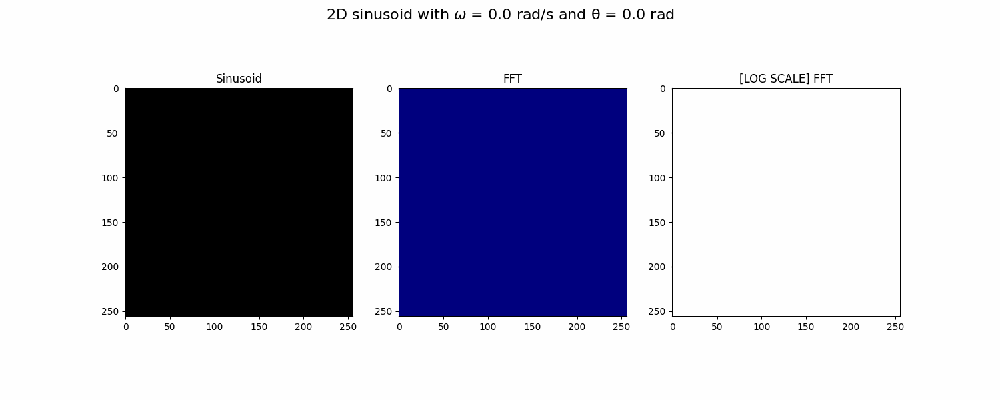

In [79]:
# fft_animation(200)
display_image(filename = image_repository + "increasing.gif")

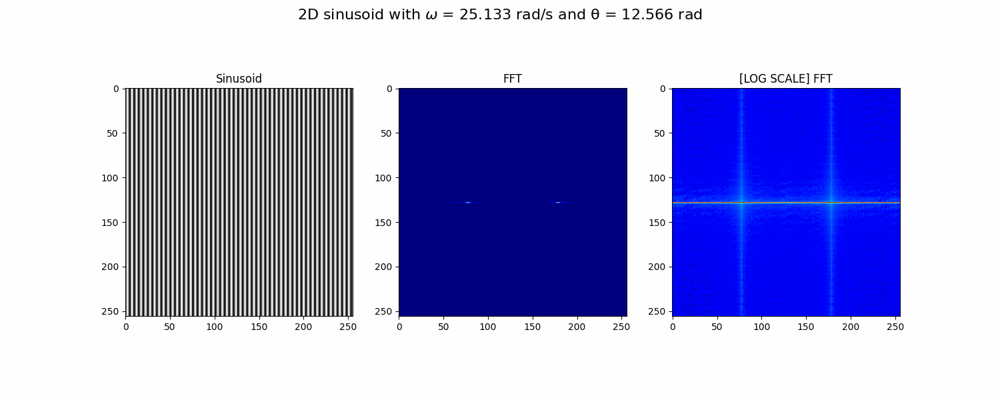

In [80]:
display_image(filename = image_repository + "decreasing.gif")

#### Masking

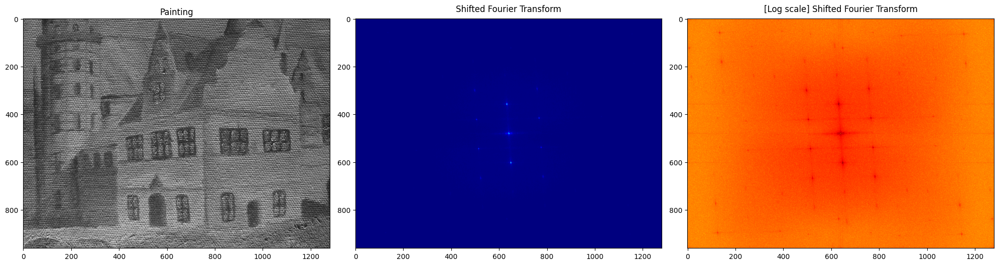

In [81]:
show_fft(convert_gs("185-8526_IMG.JPG"), "Painting", mean_center = True)

#### Masking

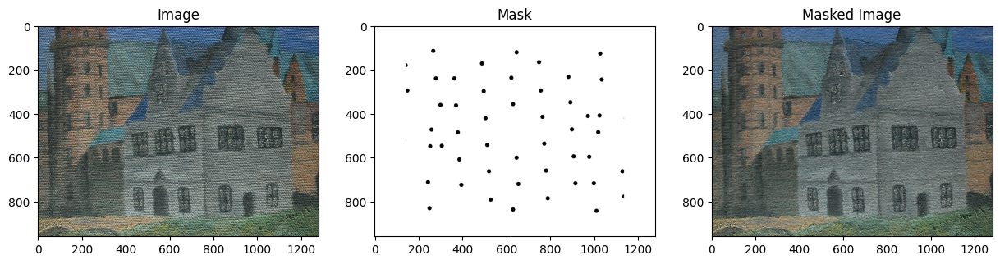

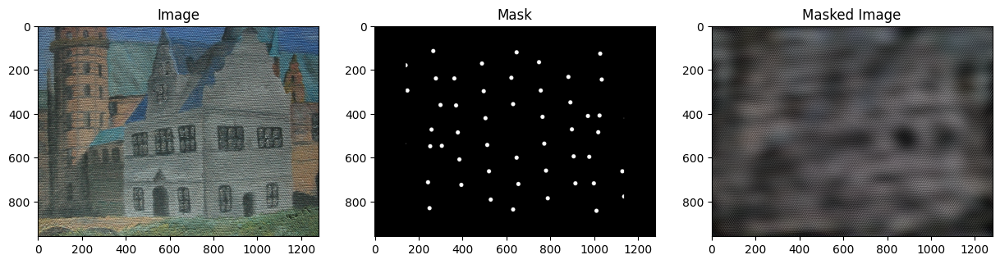

In [94]:
masking("185-8526_IMG.JPG", automate_mask("185-8526_IMG.JPG", 100, 98, 0.889))
masking("185-8526_IMG.JPG", automate_mask("185-8526_IMG.JPG", 100, 98, 0.889, invert = True))

#### Additional Masking activity - Landers Grocery Bag

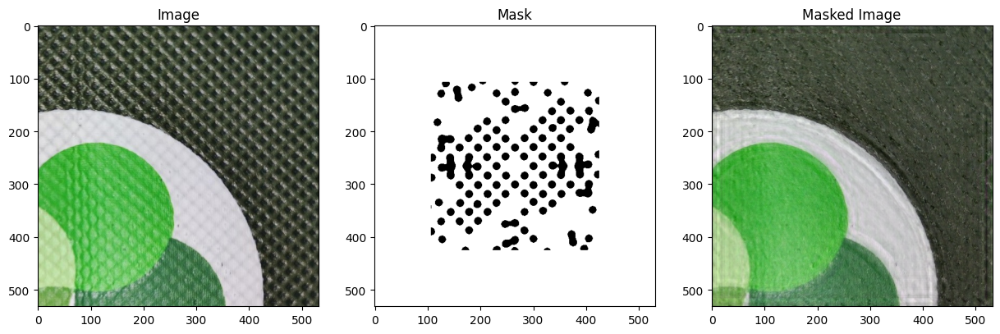

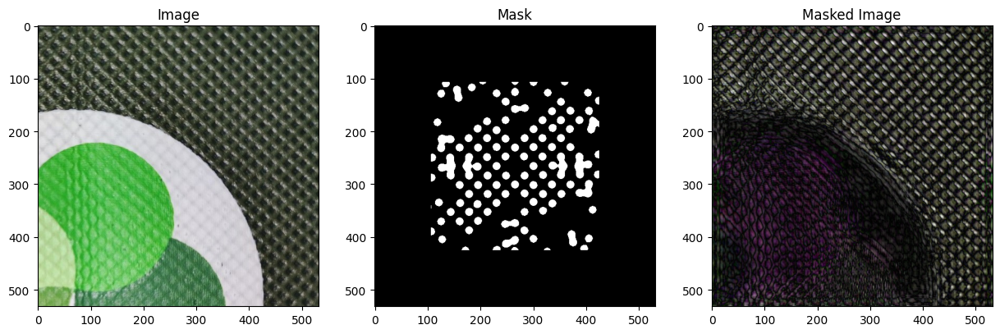

In [91]:
masking("grocery bag.jpg", automate_mask("grocery bag.jpg", 30, 80, 0.8))
masking("grocery bag.jpg", automate_mask("grocery bag.jpg", 30, 80, 0.8, invert = True))

#### Fingerprints 
source: 
Sokoto Coventry Fingerprint Dataset (SOCOFing)


#### Fingerprints of the left index finger of different people

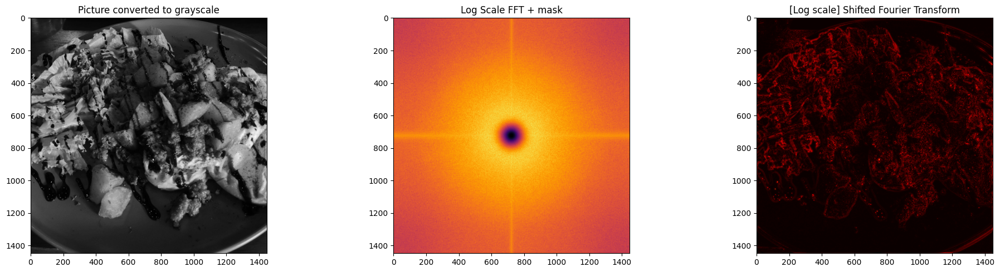

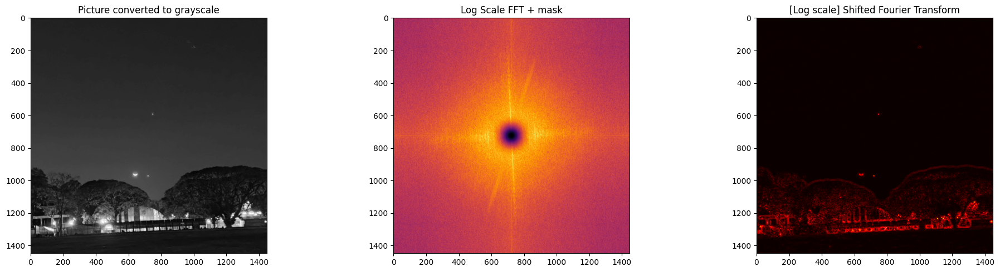

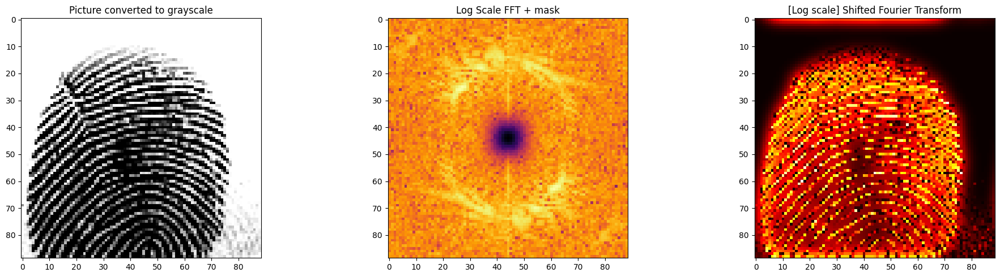

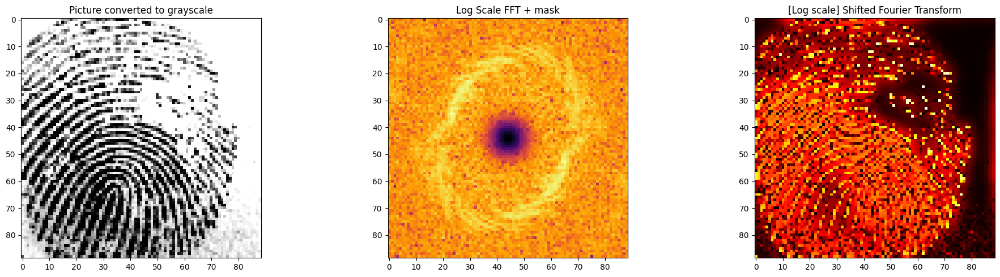

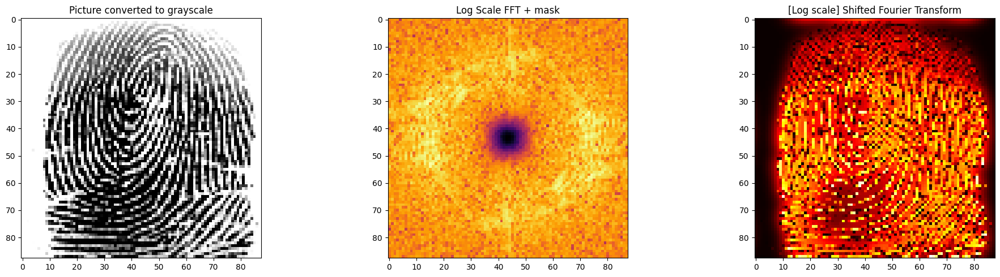

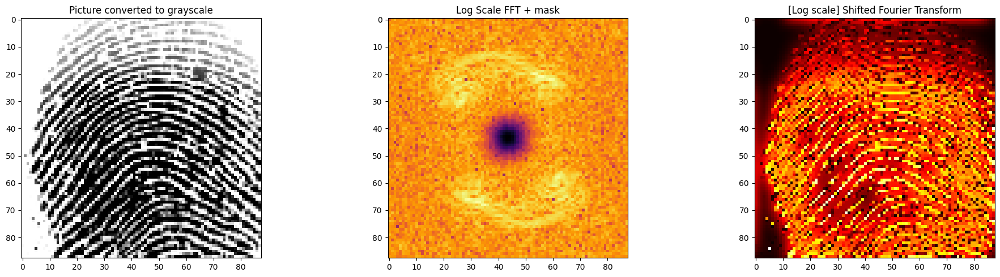

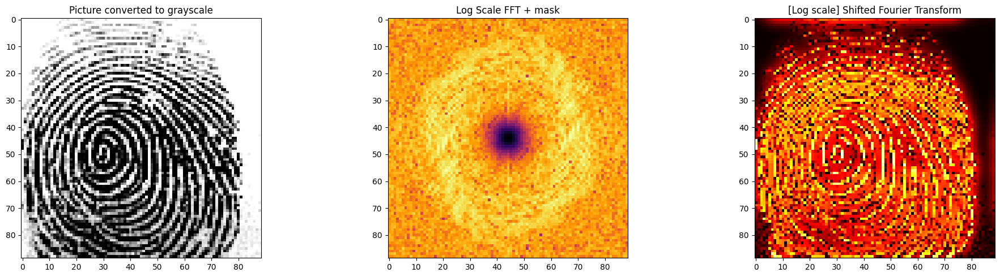

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [85]:

edge_enhancement(convert_gs("square_food.jpg"), 7)
edge_enhancement(convert_gs("square_moon.jpg"), 7)
edge_enhancement(convert_gs("101__M_Left_index_finger.dib"), 12)
edge_enhancement(convert_gs("102__M_Left_index_finger.dib"), 12)
edge_enhancement(convert_gs("103__F_Left_index_finger.dib"), 12)
edge_enhancement(convert_gs("104__M_Left_index_finger.dib"), 12)
edge_enhancement(convert_gs("105__M_Left_index_finger.dib"), 12)

#### For the Apollo landing, I'll manually create the mask

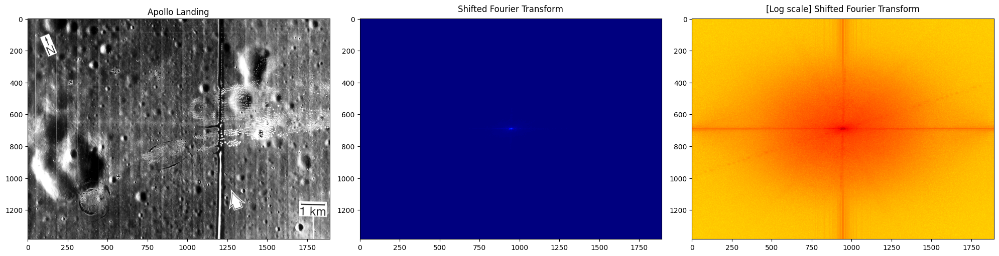

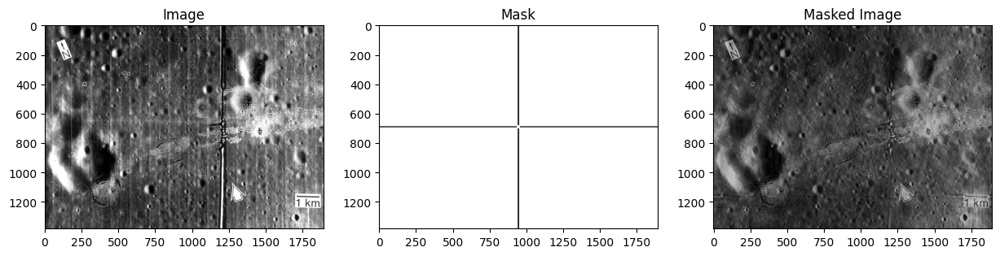

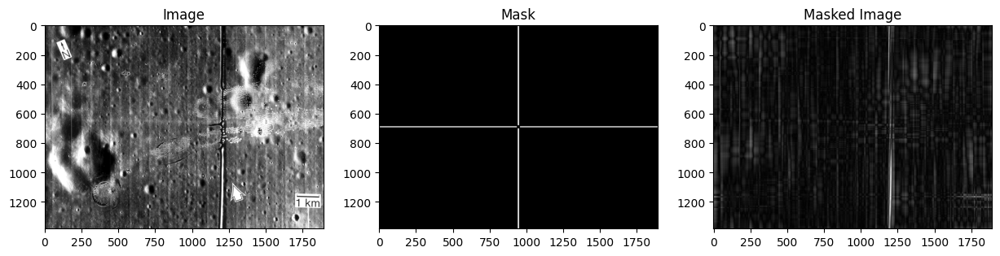

In [93]:
show_fft(convert_gs("ApolloLand05.tif"), "Apollo Landing", mean_center = True)
masking("ApolloLand05.tif", Apollo_mask("ApolloLand05.tif", 0.0025))
masking("ApolloLand05.tif", Apollo_mask("ApolloLand05.tif", 0.0025, invert = True))